# Setup

In [ ]:
# Unzip data
%%capture
!unzip '/content/drive/MyDrive/UAV/Data/NEONTreeEvaluation/NeonTreeEvaluation-1.8.0.zip' -d "/content"

In [ ]:
# Install libraries. This takes several minutes
%%capture
!pip install laspy          # for LiDAR
!pip install lazrs          # for LiDAR
!pip install rasterio       # for tiff images
!pip install supervision    # for bounding boxes / masks
!pip install deepforest     # for automatic bounding box detection
!pip install 'git+https://github.com/PatBall1/detectree2.git'                   # Detectree-2
!pip install 'git+https://github.com/facebookresearch/segment-anything-2.git'   # SAM-2

In [ ]:
# Copy lab github repository, download SAM-2 and Detectree2 weights
%%capture
%cd /content
import os
if os.path.exists('/content/UAV_Tree_Detection'):
  !rm -r /content/UAV_Tree_Detection
!git clone https://github.com/lu-liang-geo/UAV_Tree_Detection.git

if not os.path.exists('/content/sam2_weights'):
  !mkdir /content/sam2_weights
!wget -q -P /content/sam2_weights https://dl.fbaipublicfiles.com/segment_anything_2/072824/sam2_hiera_large.pt

if not os.path.exists('/content/detectree2_weights'):
  !mkdir /content/detectree2_weights
!wget -q -P /content/detectree2_weights https://zenodo.org/records/12773341/files/230729_05dates.pth
!wget -q -P /content/detectree2_weights https://zenodo.org/records/12773341/files/230103_randresize_full.pth

In [ ]:
# Import standard libraries
import os
import torch
import timeit
import warnings
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from scipy.optimize import linear_sum_assignment
from IPython.display import display

In [ ]:
# Import installed libraries
import laspy
import rasterio
import supervision as sv
from supervision.detection.utils import box_iou_batch, polygon_to_mask

from deepforest import main

from sam2.build_sam import build_sam2
from sam2.sam2_image_predictor import SAM2ImagePredictor

from detectron2.engine import DefaultPredictor
from detectree2.models.train import setup_cfg
from detectree2.models.predict import predict_on_data

%cd /content/UAV_Tree_Detection
from segment_and_detect_anything import NEONTreeDataset, segment_boxes, segment_points, segment_box_points
from segment_and_detect_anything.utils import *

from segment_and_detect_anything.detr.box_ops import custom_nms
%cd /content

/content/UAV_Tree_Detection
/content


In [ ]:
# Suppress warnings (primarily raised by DeepForest and Detectree-2)
warnings.filterwarnings("ignore")

In [ ]:
# Set device, either CPU or CUDA
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

cuda


In [ ]:
# Load SAM Model. We're currently using SAM-2
sam_model = build_sam2("sam2_hiera_l.yaml", "/content/sam2_weights/sam2_hiera_large.pt", device=device)
sam_predictor = SAM2ImagePredictor(sam_model)

In [ ]:
# Load DeepForest Model
%%capture
df_model = main.deepforest()
df_model.use_release()
df_model.to(device)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
# Load Detectree2 Model
cfg = setup_cfg(update_model='/content/detectree2_weights/230103_randresize_full.pth')
dt_model=DefaultPredictor(cfg)

In [ ]:
# Define dataset
ds = NEONTreeDataset(image_path='/content/weecology-NeonTreeEvaluation-d0b90bc/evaluation', ann_path='/content/weecology-NeonTreeEvaluation-d0b90bc/annotations')

In [ ]:
import re
from collections import Counter
# All annotation files (includes annotations for train set and possibly val set)
all_names = os.listdir('/content/weecology-NeonTreeEvaluation-d0b90bc/annotations')
print(len(all_names))
# Remove annotation files with number only filenames, not sure what images they belong to
all_names = [name[:-4] for name in all_names]
split_names = [name.split('_') for name in all_names]
alpha_names = [item for name in split_names for item in name if item.isupper()]
print(len(alpha_names))
# Total number of unique forest names. Different from paper, which lists 26. Four of those are train-only,
# but then one of those (YELL) got added to eval and a new one (TOOL) was added as well.
forest_names = Counter(alpha_names)
forest_names = sorted([(name, number) for (name, number) in forest_names.items()])
print(len(forest_names))
print()
for name, number in forest_names:
  print(name, ':', number)

227
219
24

ABBY : 2
BART : 3
BLAN : 2
BONA : 4
CLBJ : 2
DELA : 3
DSNY : 7
HARV : 4
JERC : 7
LENO : 3
MLBS : 10
NIWO : 13
ONAQ : 2
OSBS : 18
SCBI : 2
SERC : 2
SJER : 66
SOAP : 2
TALL : 3
TEAK : 53
TOOL : 1
UNDE : 3
WREF : 5
YELL : 2


# Define Functions

In [ ]:
#@title Data Functions

def get_masks(filename, rgb_folder, shape_folder, img_size=(400,400)):
  '''
  Transform shapefiles into masks.

  params:
    filename (str): Name of the image, minus extension
    rgb_folder (str): Path to saved RGB tif image.
    shape_folder (str): Path to saved shapefile.
    img_size (tuple): RGB image size in pixels (H x W)

  returns:
    masks (ndarray): Boolean mask with TRUE indicating the polygon area
                     and FALSE elsewhere
  '''
  polygons = []
  with rasterio.open(os.path.join(rgb_folder, filename+'.tif')) as rast_img:
    # Open corresponding shapefile, convert to image's CRS, clip to image bounds
    shapes = gpd.read_file(os.path.join(shape_folder, filename, filename+'.shp'))
    shapes = shapes.to_crs(rast_img.crs)
    shapes = gpd.clip(shapes, rast_img.bounds)
    # Convert shape coordinates to pixel indices, eliminate neighbors that share the same indices
    for i in range(len(shapes)):
      shape = shapes.loc[i, 'geometry']
      coords = list(shape.exterior.coords)
      pixels = [rast_img.index(x,y) for x,y in coords]
      pixels = [pixels[0]] + [pixels[i] for i in range(1,len(pixels)) if pixels[i] != pixels[i-1]]
      pixels = [(p[1],p[0]) for p in pixels]
      polygons.append(np.array(pixels, dtype='int'))
  true_masks = np.array([polygon_to_mask(poly, (img_size[1],img_size[0])) for poly in polygons], dtype=bool)

  return true_masks


def rasterize_lidar(lidar_folder, rgb_folder, filename, label=False, boxes=None,
                    classifications={'Ground':0,'High Vegetation':1}, img_size=(400,400)):
    '''
    Rasterizes and labels LiDAR points, and optionally filters bounding boxes by LiDAR points.

    If label is True, uses pre-determined labels in .laz file. If label is False and boxes is not
    None, labels LiDAR points with "Tree" classification (1) according to the box they fall into.
    If label is False and boxes is None, label all points with "Tree" classification as single label.

    If boxes is not None and box_threshold > 0.0, filters boxes by removing boxes that have less
    than `box_threshold` % of labeled LiDAR points falling within them.

    params:
        lidar_folder (str): Path to folder containing laz files
        rgb_folder (str): Path to folder containing tiff files
        filename (str): Lidar / tiff filename minus the extension
        label (bool): True if Lidar data already has "label" field with individual
                      tree labels
        boxes (np.array): T x 4 array of [x0,y0,x1,y1] bounding boxes, where T is the
                          total number of boxes (trees). If provided, used to label
                          Lidar points for individual trees.
        classifications (dict): Dictionary of LiDAR classifications. Must include
                                "High Vegetation" as a key, and the corresponding
                                integer label.
        img_size (tuple): RGB image size in pixels (H x W)

    returns:
        coord_array: 1 x P x 2 array of X,Y coordinates in pixel space, where P is the
                     number of rasterized points
        label_array: N x P array of 1s and 0s, 1 to indicate the corresponding entry in
                     coord_array is a specific tree, 0 to indicate background or a different
                     tree. If using common label for all trees, N is 1.
    '''

    # Read Lidar file
    las = laspy.read(os.path.join(lidar_folder, f'{filename}.laz'))

    # LiDAR to DataFrame
    points = np.vstack((las.x, las.y, las.classification)).transpose()
    df = pd.DataFrame(points, columns=['x', 'y', 'classification'])
    df['classification'] = df['classification'] == classifications['High Vegetation']

    # Align Lidar coordinates with tiff indices
    with rasterio.open(os.path.join(rgb_folder, filename+'.tif')) as rast_img:
        left, bottom, right, top = rast_img.bounds
        df = df[df['x'].between(left, right) & df['y'].between(bottom, top)]
        crop_idx = df.index
        # Get pixel coordinates for each point.
        pixels = [rast_img.index(x,y) for x,y in zip(df['x'], df['y'])]
    df[['y_bin','x_bin']] = pixels
    df = df.astype({'x_bin':'int', 'y_bin':'int', 'classification':'int'})
    # Re-index points on the right-most and bottom-most edges of the image
    df[['x_bin','y_bin']] = df[['x_bin','y_bin']].clip([0,0],[img_size[1]-1,img_size[0]-1])

    # If Lidar points provided in laz file, use these labels
    if label:
        df['label'] = las.label[crop_idx]
        tree_labels = [l for l in df['label'].unique() if l != 0]
        df = df.groupby(by=['x_bin','y_bin'])['label'].unique().reset_index()
        coord_array = df[['x_bin','y_bin']].to_numpy()[np.newaxis,:]
        label_array = np.zeros((len(tree_labels), coord_array.shape[1]), dtype='int')
        df = df.explode('label')
        for i, tree in enumerate(tree_labels):
            idx = df[df['label']==tree].index
            label_array[i, idx] = 1

    # Otherwise, if boxes provided, use these to label Lidar data
    elif boxes is not None:
        df = df.groupby(by=['x_bin','y_bin'])['classification'].max()
        coord_array = df.reset_index()[['x_bin','y_bin']].to_numpy()[np.newaxis,:]
        label_array = np.zeros((len(boxes), coord_array.shape[1]), dtype='int')
        for i, box in enumerate(boxes):
            s = pd.Series(data=0, index=df.index)
            xmin, xmax = box[0], box[2]
            ymin, ymax = box[1], box[3]
            s.loc[xmin:xmax, ymin:ymax] = df.loc[xmin:xmax, ymin:ymax]
            label_array[i] = s

    # Otherwise use a height threshold to label all points above height_threshold as "1" for "tree"
    else:
        df = df.groupby(by=['x_bin','y_bin'])['classification'].max().reset_index()
        coord_array = df[['x_bin','y_bin']].to_numpy()[np.newaxis,:]
        label_array = df['classification'].to_numpy(dtype='int')[np.newaxis,:]

    return coord_array, label_array


def lidar_filter(boxes, coordinates, labels, threshold=0.2):
    '''
    params:
      boxes (ndarray): N x 4 array of bounding boxes, where N is the number of boxes
      coordinates (ndarray): 1 x P x 2 array of X,Y coordinates, where P is the number
                             of points.
      labels (ndarray): N x P array of binary labels, with 1 being a tree point inside the
                        Nth box and 0 being a non-tree point inside or outside the box
      threshold (float): Percent of points inside the box that should be marked as 1 or
                         "tree" in order to keep the box and labels as legitimate

    returns:
      idx (ndarray): Indices for the remaining boxes and labels after filtering
    '''
    index = pd.MultiIndex.from_arrays([coordinates[0,:,0], coordinates[0,:,1]])
    df = pd.DataFrame(data=labels.T, index=index)
    idx = []
    for i,box in enumerate(boxes):
        xmin, xmax = box[0], box[2]
        ymin, ymax = box[1], box[3]
        box_points = df[i].loc[xmin:xmax, ymin:ymax]
        if len(box_points) > 0 and box_points.sum() / len(box_points) > threshold:
            idx.append(i)

    return np.array(idx, dtype='int')

In [ ]:
def show_as_mask(img, detections, coordinates, labels, ax=None,
                 show_positive=True, show_negative=False, show_boxes=False,
                 img_size=(400,400), fig_size=(5,5), neg_opacity=1.0, title=None,
                 save=False, output_folder='/content'):
    '''
    Display rasterized LiDAR points as mask, with one pixel per one point. Useful for visualizing images
    with large numbers of LiDAR points. Can visualize collectively labeled or individually labeled points.

    params:
        img (array): RGB image as array
        detections (sv.Detections): Annotations for image put into Supervision Detections object
        coordinates (ndarray): 1 x N x 2 array or T x N x 2 array of X,Y coordinates; if coordinates were
                               sampled using "sample_points", then T is the number of labeled trees
        labels (ndarray): T x N array of binary labels, where T is the number of labeled trees (T = 1 for
                          collective labels)
        ax (matplotlib Axes): If embedding this image in a larger matplotlib figure, pass an axis of that
                              figure as "ax". This will return the image as an Axes object and allow it
                              to be embedded in the larger figure.
        show_positive (bool): If True, show the positively labeled points (trees)
        show_negative (bool): If True, show the negatively labeled points (background)
        show_boxes (bool): If True, show the bounding boxes around trees
        img_size (tuple): Image size in pixels (H x W)
        fig_size (tuple): Display size in inches (W x H)
        neg_opacity (float): Opacity of negative points, value between 0 and 1
        title (str): Optional title to show on image. If title is provided as save is True, title will
                     also be the name of the saved file.
        save (bool): If True, save the image as png. If title is not None, will use title for save name,
                     otherwise will save as "lidar_mask.png".
        output_folder (str): Path to the folder to save image

    returns:
        None. Displays and optionally saves image with masks overlaid.
    '''
    img = img[:,:,::-1]

    # T = 1 for collective points, otherwise the number of labeled trees
    num_labels = len(labels)

    # Broadcast coordinates to T x N x 2 if not already input as such
    original_shape = coordinates.shape
    coordinates = np.broadcast_to(coordinates, (num_labels, coordinates.shape[1], coordinates.shape[2]))

    if show_positive:
        # Show tree points
        pos_mask = np.full((num_labels, img_size[0], img_size[1]), False)
        for i in range(num_labels):
            mask_index = labels[i].nonzero()[0]
            mask_coords = coordinates[i, mask_index]
            pos_mask[i,mask_coords[:,1],mask_coords[:,0]] = True
        pos_detections = sv.Detections(xyxy=detections.xyxy, mask=pos_mask, class_id=detections.class_id)
        if len(pos_detections) == 1:
          pos_annotator = sv.MaskAnnotator(color=sv.Color.RED, opacity=1)
        else:
          pos_annotator = sv.MaskAnnotator(color_lookup=sv.ColorLookup.INDEX, opacity=1)
        img = pos_annotator.annotate(scene=img.copy(), detections=pos_detections)

    if show_negative:
        # Show background points
        neg_mask = np.full((original_shape[0], img_size[0], img_size[1]), False)
        if original_shape[0] == 1:
            labels = np.max(labels, axis=0)[np.newaxis]
        for i in range(len(neg_mask)):
            mask_index = (labels[i]==0).nonzero()[0]
            mask_coords = coordinates[i, mask_index]
            neg_mask[i,mask_coords[:,1],mask_coords[:,0]] = True
        # Background points are always white for mask visualization
        neg_detections = sv.Detections(xyxy=detections.xyxy, mask=neg_mask, class_id=detections.class_id)
        neg_annotator = sv.MaskAnnotator(color=sv.Color.WHITE, opacity=neg_opacity)
        img = neg_annotator.annotate(scene=img.copy(), detections=detections)

    if show_boxes:
        # Show boxes
        box_annotator = sv.BoxAnnotator(thickness=1, color=sv.Color.RED)
        img = box_annotator.annotate(scene=img.copy(), detections=detections)

    # Display figure, optionally title and save
    return_ax = True
    if ax is None:
        fig, ax = plt.subplots(nrows=1, ncols=1, figsize=fig_size)
        return_ax = False
    ax.axis('off')
    ax.imshow(img[:,:,::-1])

    if return_ax:
        return ax

    if title:
        ax.set_title(title)
    plt.tight_layout()
    if save:
        if title:
            plt.savefig(os.path.join(output_folder, title+'.png'))
        else:
            plt.savefig(os.path.join(output_folder, 'lidar_mask.png'))
    plt.show()

In [ ]:
#@title Prediction Functions

def segment_boxes(sam_predictor, boxes, threshold=0.0) -> np.ndarray:
    result_mask = []
    for box in boxes:
        mask, scores, logits = sam_predictor.predict(
            box=box,
            multimask_output=False
        )
        if scores > threshold:
            result_mask.append(mask.astype('bool'))

    if len(result_mask) > 0:
        return np.concatenate(result_mask)
    else:
        return np.empty(shape=(0, mask.shape[0], mask.shape[1]))

def segment_points(sam_predictor, points, labels, threshold=0.0, iterative=True, return_iterations=False):
    result_mask = []
    for i, label in enumerate(labels):
        # If there is only one set of coordinates (i.e. points.shape[0]==1),
        # always use those same coordinates. If there are multiple sets of
        # coordinates (i.e. points.shape[0]>1), use different set for each label.
        # This is used for individually sampled vs collectively sampled points.
        if points.shape[0] == 1:
            tree_points = points[0]
        else:
            tree_points = points[i]

        if not iterative:
            mask, scores, logits = sam_predictor.predict(
                point_coords=tree_points,
                point_labels=label,
                multimask_output=False)
        else:
            # First Prediction,without logits
            mask, scores, logits = sam_predictor.predict(
                point_coords=tree_points[:1],
                point_labels=label[:1],
                multimask_output=False)
            if return_iterations:
                result_mask.append(mask.astype('bool'))
            # Subsequent Predictions, with logits
            for j in range(1, len(label)):
                mask, scores, logits = sam_predictor.predict(
                    point_coords=tree_points[:j+1],
                    point_labels=label[:j+1],
                    mask_input=logits,
                    multimask_output=False)
                if return_iterations:
                    result_mask.append(mask.astype('bool'))

        if not return_iterations:
            if scores > threshold:
                result_mask.append(mask.astype('bool'))

    if len(result_mask) > 0:
        return np.concatenate(result_mask)
    else:
        return np.empty(shape=(0, mask.shape[0], mask.shape[1]))

def segment_box_points(sam_predictor, boxes, points, labels, threshold=0.0, iterative=True, return_iterations=False):
    result_mask = []
    for i, box in enumerate(boxes):
        tree_points = points[i]
        tree_labels = labels[i]
        # If not iterative, use all prompts at once
        if not iterative:
            mask, scores, logits = sam_predictor.predict(
                box=box,
                point_coords=tree_points,
                point_labels=tree_labels,
                multimask_output=False)
        # Else run through prompts iteratively
        else:
            # First Prediction, using box
            mask, scores, logits = sam_predictor.predict(
                box=box,
                multimask_output=False)
            if return_iterations:
                result_mask.append(mask.astype('bool'))
            # Subsequent Predictions using box, new points, and previous mask
            for j in range(len(tree_labels)):
                mask, scores, logits = sam_predictor.predict(
                    box=box,
                    point_coords=tree_points[:j+1],
                    point_labels=tree_labels[:j+1],
                    mask_input=logits,
                    multimask_output=False)
                if return_iterations:
                    result_mask.append(mask.astype('bool'))

        if not return_iterations:
            if scores > threshold:
                result_mask.append(mask.astype('bool'))

    if len(result_mask) > 0:
        return np.concatenate(result_mask)
    else:
        return np.empty(shape=(0, mask.shape[0], mask.shape[1]))

In [ ]:
#@title Evaluation Functions

def mask_iou_batch(masks_true, masks_pred):
    intersection = np.logical_and(masks_true[:,None,...], masks_pred).sum(axis=(2,3))
    union = np.logical_or(masks_true[:,None,...], masks_pred).sum(axis=(2,3))
    iou_matrix = np.divide(intersection, union, out=np.zeros(union.shape), where=union!=0)
    return iou_matrix


def boxes_to_masks(boxes, shape):
    masks = []
    for i, box in enumerate(boxes):
        masks.append(np.full(shape, False))
        masks[i][round(box[1]):round(box[3])+1, round(box[0]):round(box[2])+1] = True
    if len(masks) > 0:
        return np.stack(masks)
    else:
        return np.empty(shape)[np.newaxis]

def hungarian_matching(truths, preds, threshold=0.0):
    '''
    Compute Hungarian Matching between ground truth masks or bounding boxes
    and predicted masks or bounding boxes.

    parameters:
        truths (array): Ground truth bounding boxes or masks
        preds (array): Predicted bounding boxes or masks
        threshold (float): Only return indexes with an IoU greater than the given threshold

    returns:
        true_idx, pred_idx (floats): corresponding indices for the truths and preds with greatest IoU
    '''
    # If both preds and truths are bounding boxes, calculate IoU between boxes and feed into hungarian algorithm
    if truths.ndim == 2 and preds.ndim == 2:
        iou_matrix = box_iou_batch(truths, preds)
        true_idx, pred_idx = linear_sum_assignment(iou_matrix, maximize=True)
        idx = np.array([i for i in range(len(true_idx)) if iou_matrix[true_idx[i], pred_idx[i]] >= threshold], dtype='int')
        return true_idx[idx], pred_idx[idx]

    # If only one is bounding boxes, convert to mask to compute IoU
    elif truths.ndim == 2:
        truths = boxes_to_masks(truths, preds.shape[1:])

    elif preds.ndim == 2:
        preds = boxes_to_masks(preds, truths.shape[1:])

    # Calculate IoU between masks, feed into hungarian algorithm
    iou_matrix = mask_iou_batch(truths, preds)
    true_idx, pred_idx = linear_sum_assignment(iou_matrix, maximize=True)
    idx = np.array([i for i in range(len(true_idx)) if iou_matrix[true_idx[i], pred_idx[i]] >= threshold], dtype='int')
    return true_idx[idx], pred_idx[idx]


def compute_iou(truths, preds, reduction='none'):
    intersection = np.logical_and(truths, preds).sum(axis=(1,2))
    union = np.logical_or(truths, preds).sum(axis=(1,2))
    iou = np.divide(intersection, union, out=np.zeros(union.shape), where=union!=0)


    # If reduction is 'mean', return the mean IoU, otherwise return all IoUs
    if reduction == 'none':
        return iou
    elif reduction == 'mean':
        return np.mean(iou)
    else:
        raise ValueError(f"reduction should be either 'mean' or 'none'.")


def segmentation_metrics(truths, preds, reduction='none'):
    precisions_per_tree = []
    recalls_per_tree = []
    f1_per_tree = []

    tp = np.logical_and(truths, preds).sum(axis=(1,2))
    fp = np.logical_and(np.logical_not(truths), preds).sum(axis=(1,2))
    fn = np.logical_and(truths, np.logical_not(preds)).sum(axis=(1,2))

    precision = np.divide(tp, (tp+fp), out=np.zeros(tp.shape), where=(tp+fp)!=0)
    recall = np.divide(tp, (tp+fn), out=np.zeros(tp.shape), where=(tp+fn)!=0)
    f1 = np.divide((2*precision*recall), (precision+recall), out=np.zeros(recall.shape), where=(precision+recall)!=0)

    if reduction == 'none':
        return precision, recall, f1
    elif reduction == 'mean':
        return np.mean(precision), np.mean(recall), np.mean(f1)
    else:
        raise ValueError(f"reduction should be either 'mean' or 'none'.")


def detection_metrics(truths, preds, threshold=0.5):
    true_idx, pred_idx = hungarian_matching(truths, preds, threshold=threshold)
    tp = len(true_idx)
    fp = len(preds) - len(pred_idx)
    fn = len(truths) - len(true_idx)

    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1 = (2 * precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

    return precision, recall, f1

# Set Image Paths / Random Seed

In [ ]:
# Define paths to folders for RGB images, LiDAR data, and ground truth polygons (shapefiles). Define filename for specific image.
# Change your own path
shape_folder = 'your_path/Annotation'
rgb_folder = '/content/weecology-NeonTreeEvaluation-d0b90bc/evaluation/RGB'
lidar_folder = 'your_path/LiDAR processing/Without LiDAR filter'

# Set random seed for reproducibility
seed = 1

# Define test images and classifications
test_imgs = [('2018_SJER_3_252000_4106000_image_234', 'Easy'), ('2018_SJER_3_254000_4108000_image_700', 'Easy'),
             ('2018_TEAK_3_318000_4107000_image_718', 'Easy'), ('DSNY_002_2018', 'Easy'), ('JERC_055_2018', 'Easy'),
             ('OSBS_051_2019', 'Easy'), ('ABBY_063_2019', 'Medium'), ('BONA_018_2019', 'Medium'), ('DSNY_025_2018', 'Medium'),
             ('SJER_025_2018', 'Medium'), ('TEAK_049_2018', 'Medium'), ('WREF_072_2019', 'Medium'), ('ABBY_076_2019', 'Hard'),
             ('BART_050_2019', 'Hard'), ('BONA_005_2019', 'Hard'), ('DELA_047_2019', 'Hard'), ('LENO_066_2019', 'Hard'),
             ('SERC_004_2019', 'Hard')]

# Define metrics dictionary that will be updated below
metrics = dict()

In [ ]:
trees = {'Easy':dict(), 'Medium':dict(), 'Hard':dict()}

for filename, difficulty in test_imgs:
  img = ds.get_image(filename)
  true_boxes = img['annotation']
  trees[difficulty][filename] = len(true_boxes)

total_trees = 0
for difficulty in ['Easy','Medium','Hard']:
  difficulty_trees = 0
  print(difficulty)
  for filename, number in trees[difficulty].items():
    print(filename, ':', number)
    difficulty_trees += number
    total_trees += number
  print()
  print(difficulty, 'Trees :', difficulty_trees)
  print()
print('Total Trees :', total_trees)

Easy
2018_SJER_3_252000_4106000_image_234 : 1
2018_SJER_3_254000_4108000_image_700 : 4
2018_TEAK_3_318000_4107000_image_718 : 1
DSNY_002_2018 : 1
JERC_055_2018 : 7
OSBS_051_2019 : 8

Easy Trees : 22

Medium
ABBY_063_2019 : 57
BONA_018_2019 : 51
DSNY_025_2018 : 46
SJER_025_2018 : 18
TEAK_049_2018 : 25
WREF_072_2019 : 20

Medium Trees : 217

Hard
ABBY_076_2019 : 103
BART_050_2019 : 51
BONA_005_2019 : 59
DELA_047_2019 : 45
LENO_066_2019 : 47
SERC_004_2019 : 48

Hard Trees : 353

Total Trees : 592


In [ ]:
import xml.etree.ElementTree as ET

ann = set([name[:-4] for name in os.listdir('/content/weecology-NeonTreeEvaluation-d0b90bc/annotations')])
rgb = set([name[:-4] for name in os.listdir('/content/weecology-NeonTreeEvaluation-d0b90bc/evaluation/RGB')])
lidar = set([name[:-4] for name in os.listdir('/content/weecology-NeonTreeEvaluation-d0b90bc/evaluation/LiDAR')])

ann_rgb = ann.intersection(rgb)
ann_rgb_lidar = ann.intersection(rgb.intersection(lidar))

print('Annotations :', len(ann))
print('RGB Data    :', len(rgb))
print('LiDAR Data  :', len(lidar))
print()
print('Annotated RGB Data         :', len(ann_rgb))
print('Annotated RGB + LiDAR Data :', len(ann_rgb_lidar))
print()

ann_path = '/content/weecology-NeonTreeEvaluation-d0b90bc/annotations'
total_trees = 0
for filename in ann_rgb_lidar:
  xyxy = []
  tree = ET.parse(os.path.join(ann_path, filename + '.xml'))
  root = tree.getroot()
  for obj in root.findall('object'):
    name = obj.find('name').text
    if name == 'Tree':
      bbox = obj.find('bndbox')
      xyxy.append([int(bbox[i].text)-1 for i in range(4)])
  annotation = np.array(xyxy)
  total_trees += len(annotation)
print('Annotated Trees with RGB and LiDAR Data :', total_trees-1)

Annotations : 227
RGB Data    : 2291
LiDAR Data  : 2186

Annotated RGB Data         : 194
Annotated RGB + LiDAR Data : 190

Annotated Trees with RGB and LiDAR Data : 6294


# Box and Point Workflows

## Boxes with LiDAR Filter

In [ ]:
filter_methods = ['Manual Boxes', 'DeepForest Filtered', 'Detectree2 Filtered', 'Baseline Filtered']
filter_index = [(img[1], method, img[0]) for method in filter_methods for img in test_imgs]
filter_index = pd.MultiIndex.from_tuples(filter_index, names=['Difficulty', 'Method', 'Filename'])
columns = [('Detection','Precision'), ('Detection','Recall'),('Detection','F1'),
           ('Segmentation','Precision'), ('Segmentation','Recall'), ('Segmentation','F1'),
           ('Segmentation','IoU')]
columns = pd.MultiIndex.from_tuples(columns)
filter_metrics = pd.DataFrame(index=filter_index, columns=columns)

for filename, difficulty in test_imgs:
  # Get image
  img = ds.get_image(filename)
  rgb_img = img['rgb']
  bgr_img = rgb_img[:,:,::-1].copy()
  sam_predictor.set_image(rgb_img)

  # Collect true bounding boxes and masks
  true_boxes = img['annotation']
  true_masks = get_masks(filename, rgb_folder, os.path.join(shape_folder, f'{difficulty}_annotate'))

  # Align true bounding boxes and masks
  box_idx, mask_idx = hungarian_matching(true_boxes, true_masks)
  true_boxes = true_boxes[box_idx]
  true_masks = true_masks[mask_idx]

  # Collect Manual bounding boxes
  hand_boxes = img['annotation']

  # Generate automatic bounding boxes using DeepForest
  df_boxes = df_model.predict_image(image=rgb_img.astype('float32'), return_plot=False)

  # Filter with confidence threshold of 0.2
  df_boxes = df_boxes[df_boxes['score'] >= 0.2]
  df_scores = df_boxes['score'].to_numpy()
  df_boxes = df_boxes[['xmin','ymin','xmax','ymax']].to_numpy()

  # Apply custom non-max suppression
  df_detections = sv.Detections(xyxy=df_boxes, confidence=df_scores, class_id=np.zeros(len(df_scores),dtype='int'))
  df_idx = custom_nms(df_detections, threshold=0.5)
  df_boxes = df_boxes[df_idx]
  df_scores = df_scores[df_idx]

  # Generate automatic bounding boxes using Detectree2
  dt_outputs = dt_model(bgr_img)
  dt_boxes = dt_outputs['instances'].pred_boxes.tensor.cpu().numpy()
  dt_scores = dt_outputs['instances'].scores.cpu().numpy()
  dt_classes = dt_outputs['instances'].pred_classes.cpu().numpy()
  dt_cnn_masks = dt_outputs['instances'].pred_masks.cpu().numpy()

  # Filter with confidence threshold of 0.2
  dt_idx = np.nonzero(dt_scores >= 0.2)
  dt_boxes = dt_boxes[dt_idx]
  dt_scores = dt_scores[dt_idx]
  dt_classes = dt_classes[dt_idx]
  dt_cnn_masks = dt_cnn_masks[dt_idx]

  # Apply custom non-max suppression
  dt_detections = sv.Detections(xyxy=dt_boxes, confidence=dt_scores, class_id=dt_classes)
  dt_idx = custom_nms(dt_detections, threshold=0.5)
  dt_boxes = dt_boxes[dt_idx]
  dt_scores = dt_scores[dt_idx]
  dt_classes = dt_classes[dt_idx]
  dt_cnn_masks = dt_cnn_masks[dt_idx]

  # Use boxes to label LiDAR points
  df_coords, df_labels = rasterize_lidar(lidar_folder, rgb_folder, filename, boxes=df_boxes)
  dt_coords, dt_labels = rasterize_lidar(lidar_folder, rgb_folder, filename, boxes=dt_boxes)

  # Use labeled LiDAR points to filter boxes
  df_idx = lidar_filter(df_boxes, df_coords, df_labels)
  df_boxes, df_labels = df_boxes[df_idx], df_labels[df_idx]
  dt_idx = lidar_filter(dt_boxes, dt_coords, dt_labels)
  dt_boxes, dt_labels, dt_cnn_masks = dt_boxes[dt_idx], dt_labels[dt_idx], dt_cnn_masks[dt_idx]

  # Segment using SAM-2 (mask threshold of 0.2)
  hand_masks = segment_boxes(sam_predictor, hand_boxes, threshold=0.2)
  if len(df_boxes) > 0:
    df_masks = segment_boxes(sam_predictor, df_boxes, threshold=0.2)
  else:
    df_masks = np.empty((0,400,400))
  if len(dt_boxes) > 0:
    dt_masks = segment_boxes(sam_predictor, dt_boxes, threshold=0.2)
  else:
    dt_masks = np.empty((0,400,400))

  # Match predicted masks to boxes (in case of filtered out masks)
  box_idx, mask_idx = hungarian_matching(df_boxes, df_masks)
  df_boxes, df_masks = df_boxes[box_idx], df_masks[mask_idx]
  box_idx, mask_idx = hungarian_matching(dt_boxes, dt_masks)
  dt_boxes, dt_masks = dt_boxes[box_idx], dt_masks[mask_idx]

  # Calculate detection based metrics for masks using 50% threshold
  hand_detect_metrics = detection_metrics(true_masks, hand_masks)
  df_detect_metrics = detection_metrics(true_masks, df_masks)
  dt_detect_metrics = detection_metrics(true_masks, dt_masks)
  dt_cnn_detect_metrics = detection_metrics(true_masks, dt_cnn_masks)

  # For correct detections (based on boxes), calculate IoU and Segmentation metrics
  true_idx, hand_idx = hungarian_matching(true_boxes, hand_boxes, threshold=0.5)
  hand_iou_metric = compute_iou(true_masks[true_idx], hand_masks[hand_idx], reduction='mean')
  hand_seg_metrics = segmentation_metrics(true_masks[true_idx], hand_masks[hand_idx], reduction='mean')

  true_idx, df_idx = hungarian_matching(true_boxes, df_boxes, threshold=0.5)
  df_iou_metric = compute_iou(true_masks[true_idx], df_masks[df_idx], reduction='mean')
  df_seg_metrics = segmentation_metrics(true_masks[true_idx], df_masks[df_idx], reduction='mean')

  true_idx, dt_idx = hungarian_matching(true_boxes, dt_boxes, threshold=0.5)
  dt_iou_metric = compute_iou(true_masks[true_idx], dt_masks[dt_idx], reduction='mean')
  dt_seg_metrics = segmentation_metrics(true_masks[true_idx], dt_masks[dt_idx], reduction='mean')

  true_idx, dt_cnn_idx = hungarian_matching(true_boxes, dt_boxes, threshold=0.5)
  dt_cnn_iou_metric = compute_iou(true_masks[true_idx], dt_cnn_masks[dt_cnn_idx], reduction='mean')
  dt_cnn_seg_metrics = segmentation_metrics(true_masks[true_idx], dt_cnn_masks[dt_cnn_idx], reduction='mean')

  # Store metrics
  filter_metrics.loc[difficulty, 'Manual Boxes', filename] = hand_detect_metrics + hand_seg_metrics + (hand_iou_metric,)
  filter_metrics.loc[difficulty, 'DeepForest Filtered', filename] = df_detect_metrics + df_seg_metrics + (df_iou_metric,)
  filter_metrics.loc[difficulty, 'Detectree2 Filtered', filename] = dt_detect_metrics + dt_seg_metrics + (dt_iou_metric,)
  filter_metrics.loc[difficulty, 'Baseline Filtered', filename] = dt_cnn_detect_metrics + dt_cnn_seg_metrics + (dt_cnn_iou_metric,)

# Save Metrics
filter_metrics.to_csv('Filtered Box Workflow Metrics.csv')

filter_order = [(difficulty, method) for difficulty in ['Easy','Medium','Hard'] for method in filter_methods]
filter_diff_metrics = filter_metrics.groupby(by=['Difficulty','Method']).mean().reindex(filter_order)
display(filter_diff_metrics)
print()
filter_avg_metrics = filter_metrics.groupby(by=['Method']).mean().reindex(filter_methods)
display(filter_avg_metrics)

Detection                     Segmentation  \
                               Precision    Recall        F1    Precision   
Difficulty Method                                                           
Easy       Manual Boxes         0.955357  0.955357  0.955357     0.885163   
           DeepForest Filtered  0.617424  0.848214  0.699647     0.913108   
           Detectree2 Filtered  0.627778  0.654762  0.623016     0.900378   
           Baseline Filtered    0.594444  0.630952  0.595238     0.911789   
Medium     Manual Boxes         0.904952  0.904952  0.904952     0.939742   
           DeepForest Filtered  0.663937  0.692095  0.668727      0.94839   
           Detectree2 Filtered  0.463024  0.304537  0.348629     0.888599   
           Baseline Filtered    0.438299  0.294367  0.334858     0.878082   
Hard       Manual Boxes         0.889674  0.889674  0.889674     0.927943   
           DeepForest Filtered  0.556151  0.593454  0.569549     0.933359   
           Detectree2 Filtered  0.611583   0.37317  0.455498     0.896198   
           Baseline Filtered    0.578776    0.3498  0.428215     0.873939   

                                                              
                                  Recall        F1       IoU  
Difficulty Method                                             
Easy       Manual Boxes         0.748752  0.800742  0.677441  
           DeepForest Filtered  0.783578  0.834487  0.723333  
           Detectree2 Filtered  0.843283  0.866629  0.775579  
           Baseline Filtered    0.829968  0.862803  0.768693  
Medium     Manual Boxes         0.710673  0.798232   0.67766  
           DeepForest Filtered  0.698489   0.78918  0.664228  
           Detectree2 Filtered  0.864656   0.86686  0.770761  
           Baseline Filtered    0.852754  0.853438  0.750121  
Hard       Manual Boxes         0.693264  0.785108  0.658225  
           DeepForest Filtered  0.684463  0.778354  0.647464  
           Detectree2 Filtered   0.83093  0.854892  0.753306  
           Baseline Filtered    0.806088  0.829998  0.715059

Detection                     Segmentation            \
                    Precision    Recall        F1    Precision    Recall   
Method                                                                     
Manual Boxes         0.916661  0.916661  0.916661     0.917616  0.717563   
DeepForest Filtered  0.612504  0.711254  0.645974     0.931619  0.722177   
Detectree2 Filtered  0.567462  0.444156  0.475714     0.894746  0.846467   
Baseline Filtered    0.537173   0.42504  0.452771     0.886533  0.829582   

                                         
                           F1       IoU  
Method                                   
Manual Boxes         0.794694  0.671109  
DeepForest Filtered  0.800674  0.678342  
Detectree2 Filtered  0.862568  0.766017  
Baseline Filtered     0.84792  0.743209

# Box to Mask Comparison

In [ ]:
comparison_folder = '/content/drive/MyDrive/Sam+LiDAR/Experiments/Box to Mask Comparison'
box_methods = ['Manual Boxes', 'DeepForest Boxes','Detectree2 Boxes', 'Baseline']
box_mask_metrics = pd.read_csv(os.path.join(comparison_folder, 'Box to Mask Comparison.csv'), index_col=[0,1,2], header=[0,1])
box_mask_avg = box_mask_metrics.groupby(by=['Method']).mean().reindex(box_methods)
box_mask_std = box_mask_metrics.groupby(by=['Method']).std().reindex(box_methods)
display(box_mask_avg)
print()
display(box_mask_std)

Box                          Mask                    
                 Precision    Recall        F1 Precision    Recall        F1
Method                                                                      
Manual Boxes      1.000000  1.000000  1.000000  0.916661  0.916661  0.916661
DeepForest Boxes  0.611617  0.742547  0.655672  0.584661  0.718199  0.629666
Detectree2 Boxes  0.277630  0.374703  0.246775  0.365714  0.451101  0.320069
Baseline          0.277630  0.374703  0.246775  0.345404  0.431984  0.302350

Box                          Mask                    
                 Precision    Recall        F1 Precision    Recall        F1
Method                                                                      
Manual Boxes      0.000000  0.000000  0.000000  0.069611  0.069611  0.069611
DeepForest Boxes  0.208957  0.172413  0.171646  0.174810  0.160970  0.139163
Detectree2 Boxes  0.186926  0.318391  0.153796  0.234453  0.306110  0.185373
Baseline          0.186926  0.318391  0.153796  0.220489  0.308727  0.174826

# Main Metrics

In [ ]:
metrics_folder = '/content/drive/MyDrive/Sam+LiDAR/Experiments/Main Metrics(no noise filter)'

main_methods = ['Manual Boxes', 'Manual + LiDAR', 'DeepForest Boxes', 'DeepForest + LiDAR',
               'Detectree2 Boxes', 'Detectree2 + LiDAR', 'Baseline', 'Baseline Filtered']
main_order = [(difficulty, method, name) for _, difficulty in test_imgs for method in main_methods for name, _ in test_imgs]

metrics = pd.read_csv('/content/Box Workflow Metrics.csv', index_col=[0,1,2], header=[0,1])
point_metrics = pd.read_csv('/content/Box + LiDAR Workflow Metrics.csv', index_col=[0,1,2], header=[0,1])

main_metrics = pd.concat((metrics, point_metrics)).loc[(['Easy','Medium','Hard'], main_methods),]
main_metrics.to_csv(os.path.join(metrics_folder, 'Main Metrics - All Results.csv'))

main_metrics = pd.read_csv(os.path.join(metrics_folder, 'Main Metrics - All Results.csv'), index_col=[0,1,2], header=[0,1])
display(main_metrics)
print()

diff_order = [(difficulty, method) for difficulty in ['Easy','Medium','Hard'] for method in main_methods]
main_diff_metrics = main_metrics.groupby(by=['Difficulty','Method']).mean().reindex(diff_order)
main_diff_metrics.to_csv(os.path.join(metrics_folder, 'Main Metrics - Avg by Difficulty.csv'))

main_diff_metrics = pd.read_csv(os.path.join(metrics_folder, 'Main Metrics - Avg by Difficulty.csv'), index_col=[0,1], header=[0,1])
display(main_diff_metrics)
print()

main_avg_metrics = main_metrics.groupby(by=['Method']).mean().reindex(main_methods)
main_avg_metrics.to_csv(os.path.join(metrics_folder, 'Main Metrics - Avg by Method.csv'))

main_avg_metrics = pd.read_csv(os.path.join(metrics_folder, 'Main Metrics - Avg by Method.csv'), index_col=[0], header=[0,1])
display(main_avg_metrics)

Detection  \
                                                                  Precision   
Difficulty Method            Filename                                         
Easy       Manual Boxes      2018_SJER_3_252000_4106000_image_234  1.000000   
                             2018_SJER_3_254000_4108000_image_700  1.000000   
                             2018_TEAK_3_318000_4107000_image_718  1.000000   
                             DSNY_002_2018                         1.000000   
                             JERC_055_2018                         0.857143   
...                                                                     ...   
Hard       Baseline Filtered BART_050_2019                         0.700000   
                             BONA_005_2019                         0.500000   
                             DELA_047_2019                         0.625000   
                             LENO_066_2019                         0.677419   
                             SERC_004_2019                         0.541667   

                                                                             \
                                                                     Recall   
Difficulty Method            Filename                                         
Easy       Manual Boxes      2018_SJER_3_252000_4106000_image_234  1.000000   
                             2018_SJER_3_254000_4108000_image_700  1.000000   
                             2018_TEAK_3_318000_4107000_image_718  1.000000   
                             DSNY_002_2018                         1.000000   
                             JERC_055_2018                         0.857143   
...                                                                     ...   
Hard       Baseline Filtered BART_050_2019                         0.549020   
                             BONA_005_2019                         0.271186   
                             DELA_047_2019                         0.444444   
                             LENO_066_2019                         0.446809   
                             SERC_004_2019                         0.270833   

                                                                             \
                                                                         F1   
Difficulty Method            Filename                                         
Easy       Manual Boxes      2018_SJER_3_252000_4106000_image_234  1.000000   
                             2018_SJER_3_254000_4108000_image_700  1.000000   
                             2018_TEAK_3_318000_4107000_image_718  1.000000   
                             DSNY_002_2018                         1.000000   
                             JERC_055_2018                         0.857143   
...                                                                     ...   
Hard       Baseline Filtered BART_050_2019                         0.615385   
                             BONA_005_2019                         0.351648   
                             DELA_047_2019                         0.519481   
                             LENO_066_2019                         0.538462   
                             SERC_004_2019                         0.361111   

                                                                  Segmentation  \
                                                                     Precision   
Difficulty Method            Filename                                            
Easy       Manual Boxes      2018_SJER_3_252000_4106000_image_234     0.809179   
                             2018_SJER_3_254000_4108000_image_700     0.892964   
                             2018_TEAK_3_318000_4107000_image_718     0.937771   
                             DSNY_002_2018                            0.867498   
                             JERC_055_2018                            0.900498   
...                                                                        ...   
Hard   

Detection                     Segmentation  \
                              Precision    Recall        F1    Precision   
Difficulty Method                                                          
Easy       Manual Boxes        0.955357  0.955357  0.955357     0.885163   
           Manual + LiDAR      0.910714  0.910714  0.910714     0.878478   
           DeepForest Boxes    0.589646  0.869048  0.678704     0.913102   
           DeepForest + LiDAR  0.617424  0.848214  0.699647     0.903559   
           Detectree2 Boxes    0.121740  0.675595  0.188016     0.900378   
           Detectree2 + LiDAR  0.566667  0.610119  0.571429     0.913008   
           Baseline            0.111936  0.651786  0.174127     0.911789   
           Baseline Filtered   0.594444  0.630952  0.595238     0.911789   
Medium     Manual Boxes        0.904952  0.904952  0.904952     0.939742   
           Manual + LiDAR      0.930417  0.930417  0.930417     0.898903   
           DeepForest Boxes    0.620405  0.692095  0.646635     0.948390   
           DeepForest + LiDAR  0.666362  0.694543  0.671215     0.915421   
           Detectree2 Boxes    0.374086  0.304537  0.320426     0.888599   
           Detectree2 + LiDAR  0.417155  0.285700  0.324359     0.832430   
           Baseline            0.354428  0.294367  0.307953     0.878082   
           Baseline Filtered   0.438299  0.294367  0.334858     0.878082   
Hard       Manual Boxes        0.889674  0.889674  0.889674     0.927943   
           Manual + LiDAR      0.923002  0.923002  0.923002     0.869454   
           DeepForest Boxes    0.543931  0.593454  0.563660     0.933359   
           DeepForest + LiDAR  0.601124  0.648153  0.618859     0.883014   
           Detectree2 Boxes    0.601315  0.373170  0.451765     0.896198   
           Detectree2 + LiDAR  0.556722  0.337919  0.412907     0.798514   
           Baseline            0.569848  0.349800  0.424969     0.873939   
           Baseline Filtered   0.578776  0.349800  0.428215     0.873939   

                                                             
                                 Recall        F1       IoU  
Difficulty Method                                            
Easy       Manual Boxes        0.748752  0.800742  0.677441  
           Manual + LiDAR      0.736533  0.792130  0.662448  
           DeepForest Boxes    0.788855  0.837829  0.728400  
           DeepForest + LiDAR  0.803598  0.844749  0.738904  
           Detectree2 Boxes    0.843283  0.866629  0.775579  
           Detectree2 + LiDAR  0.880487  0.894090  0.810789  
           Baseline            0.829968  0.862803  0.768693  
           Baseline Filtered   0.829968  0.862803  0.768693  
Medium     Manual Boxes        0.710673  0.798232  0.677660  
           Manual + LiDAR      0.766787  0.814808  0.698934  
           DeepForest Boxes    0.698489  0.789180  0.664228  
           DeepForest + LiDAR  0.751871  0.808463  0.689522  
           Detectree2 Boxes    0.864656  0.866860  0.770761  
           Detectree2 + LiDAR  0.897830  0.850581  0.748640  
           Baseline            0.852754  0.853438  0.750121  
           Baseline Filtered   0.852754  0.853438  0.750121  
Hard       Manual Boxes        0.693264  0.785108  0.658225  
           Manual + LiDAR      0.779549  0.811498  0.692277  
           DeepForest Boxes    0.684463  0.778354  0.647464  
           DeepForest + LiDAR  0.761324  0.804237  0.680800  
           Detectree2 Boxes    0.830930  0.854892  0.753306  
           Detectree2 + LiDAR  0.889733  0.833455  0.721364  
           Baseline            0.806088  0.829998  0.715059  
           Baseline Filtered   0.806088  0.829998  0.715059

Detection                     Segmentation            \
                   Precision    Recall        F1    Precision    Recall   
Method                                                                    
Manual Boxes        0.916661  0.916661  0.916661     0.917616  0.717563   
Manual + LiDAR      0.921378  0.921378  0.921378     0.882278  0.760957   
DeepForest Boxes    0.584661  0.718199  0.629666     0.931617  0.723936   
DeepForest + LiDAR  0.628303  0.730303  0.663240     0.900665  0.772264   
Detectree2 Boxes    0.365714  0.451101  0.320069     0.894746  0.846467   
Detectree2 + LiDAR  0.513515  0.411246  0.436232     0.844159  0.889871   
Baseline            0.345404  0.431984  0.302350     0.886533  0.829582   
Baseline Filtered   0.537173  0.425040  0.452771     0.886533  0.829582   

                                        
                          F1       IoU  
Method                                  
Manual Boxes        0.794694  0.671109  
Manual + LiDAR      0.806145  0.684553  
DeepForest Boxes    0.801788  0.680031  
DeepForest + LiDAR  0.819150  0.703075  
Detectree2 Boxes    0.862568  0.766017  
Detectree2 + LiDAR  0.857333  0.757292  
Baseline            0.847920  0.743209  
Baseline Filtered   0.847920  0.743209

In [ ]:
columns = [('Detection','Precision'), ('Detection','Recall'),('Detection','F1'),
           ('Segmentation','Precision'), ('Segmentation','Recall'), ('Segmentation','F1'), ('Segmentation','IoU')]

df = main_avg_metrics.loc[:,columns]

styles = {'Manual Boxes': [{'selector':'th','props':'background-color: white'},
                           {'selector':'td','props':'background-color: white'}],
          'Manual + LiDAR': [{'selector':'th','props':'background-color: white'},
                             {'selector':'td','props':'background-color: white'}],
          'DeepForest Boxes': [{'selector':'th','props':'background-color: #f2f2f2'},
                               {'selector':'td','props':'background-color: #f2f2f2'}],
          'DeepForest + LiDAR': [{'selector':'th','props':'background-color: #f2f2f2'},
                                 {'selector':'td','props':'background-color: #f2f2f2'}],
          'Detectree2 Boxes': [{'selector':'th','props':'background-color: white'},
                               {'selector':'td','props':'background-color: white'}],
          'Detectree2 + LiDAR': [{'selector':'th','props':'background-color: white'},
                                 {'selector':'td','props':'background-color: white'}],
          'Baseline': [{'selector':'th','props':'background-color: #f2f2f2'},
                       {'selector':'td','props':'background-color: #f2f2f2'}],
          'Baseline Filtered': [{'selector':'th','props':'background-color: #f2f2f2'},
                                {'selector':'td','props':'background-color: #f2f2f2'}]}


styler = df.style \
  .format('{:.1%}') \
  .set_table_styles(styles, axis=1) \
  .set_table_styles([{'selector':'th','props':'text-align: left'}], overwrite=False) \
  .hide(axis=0, names=True)

styler

In [ ]:
main_methods = ['Manual Boxes', 'Manual + LiDAR', 'DeepForest Boxes', 'DeepForest + LiDAR',
                'Detectree2 Boxes', 'Detectree2 + LiDAR', 'Baseline', 'Baseline Filtered']
stds = main_metrics.groupby(by='Method').std().reindex(main_methods)
stds_style = stds.style
stds_style.use(styler.export()).format('{:.1%}')
stds_style

# Main Workflows with Images

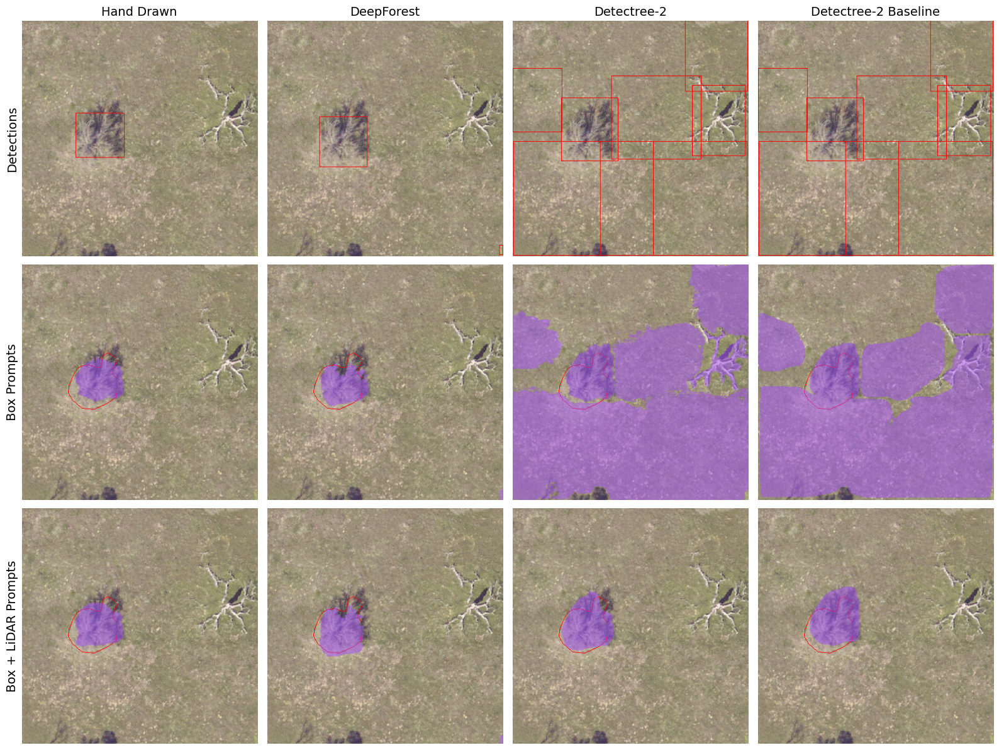

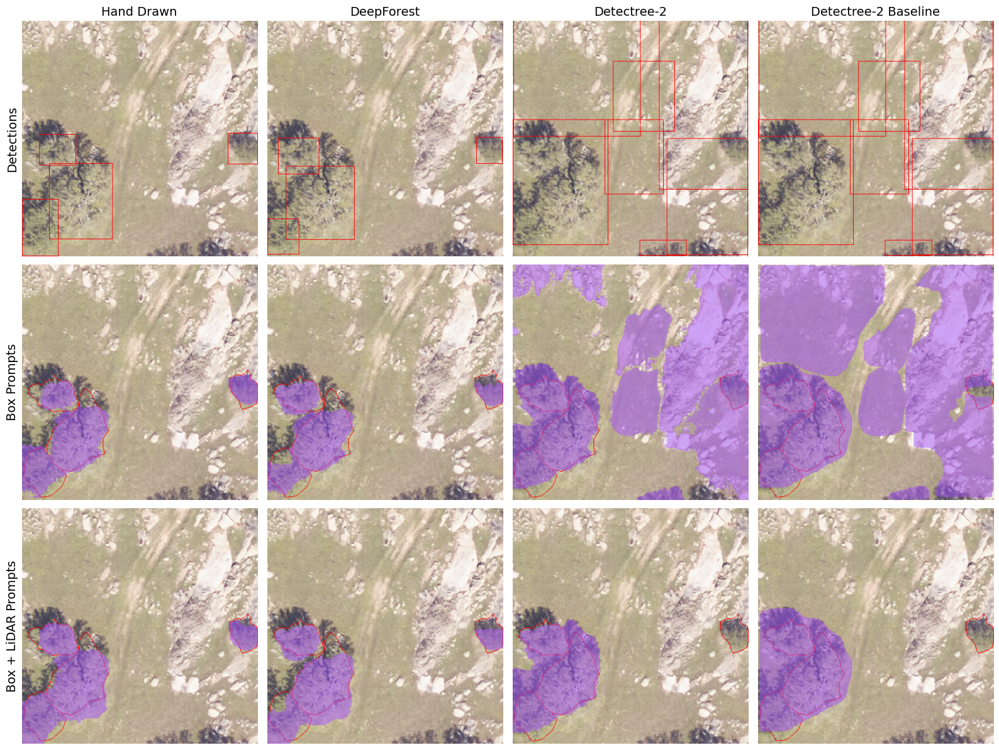

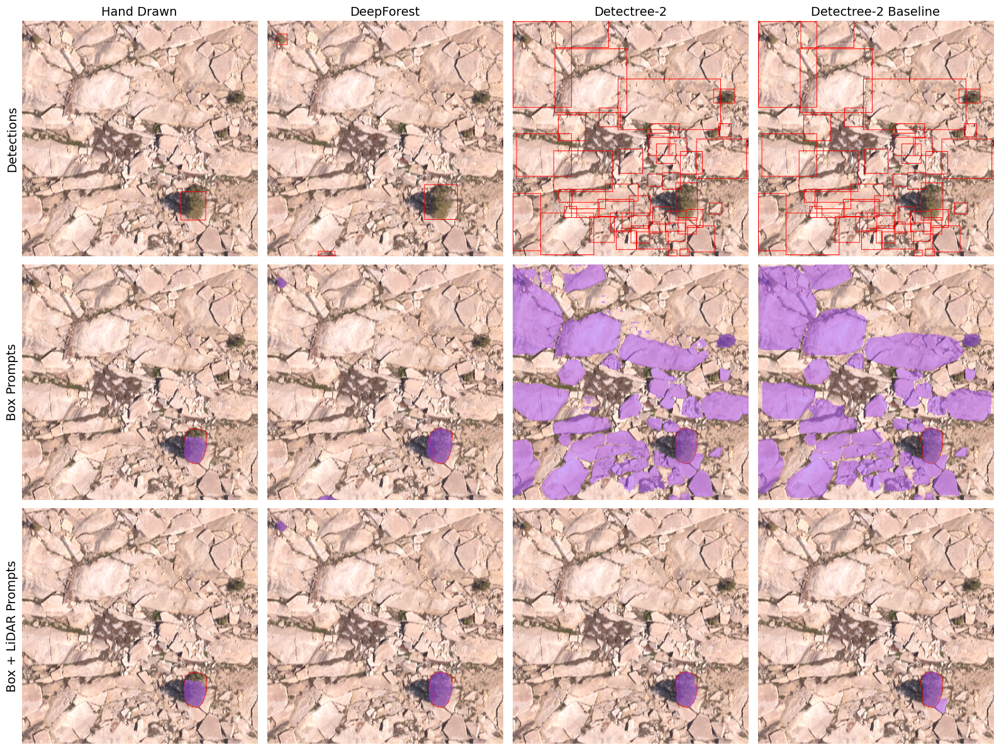

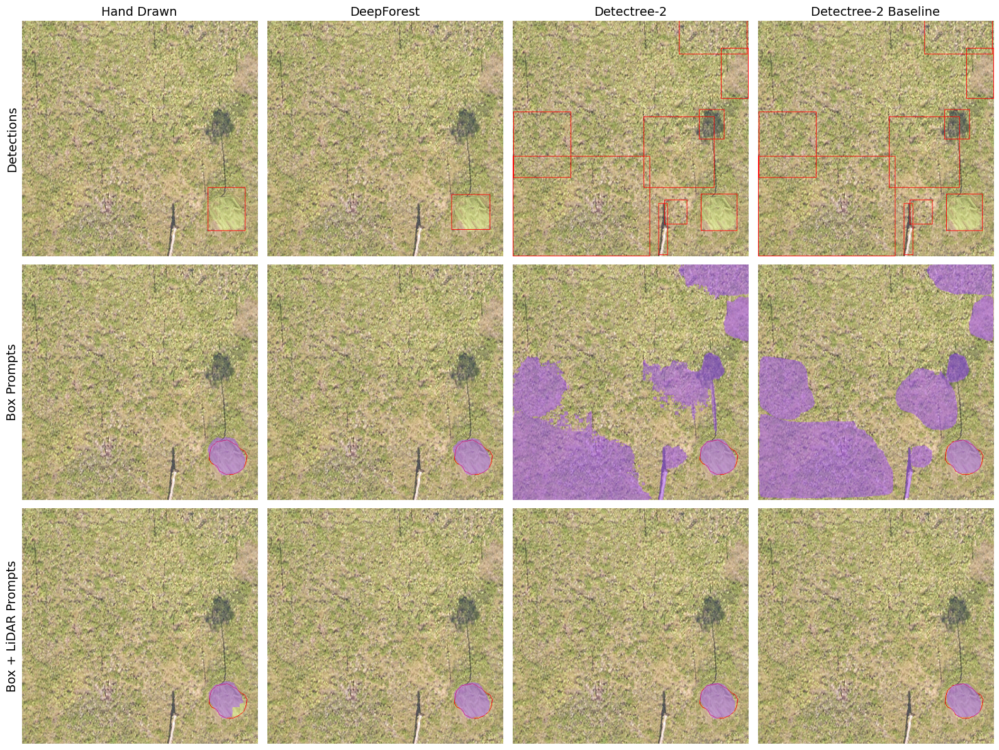

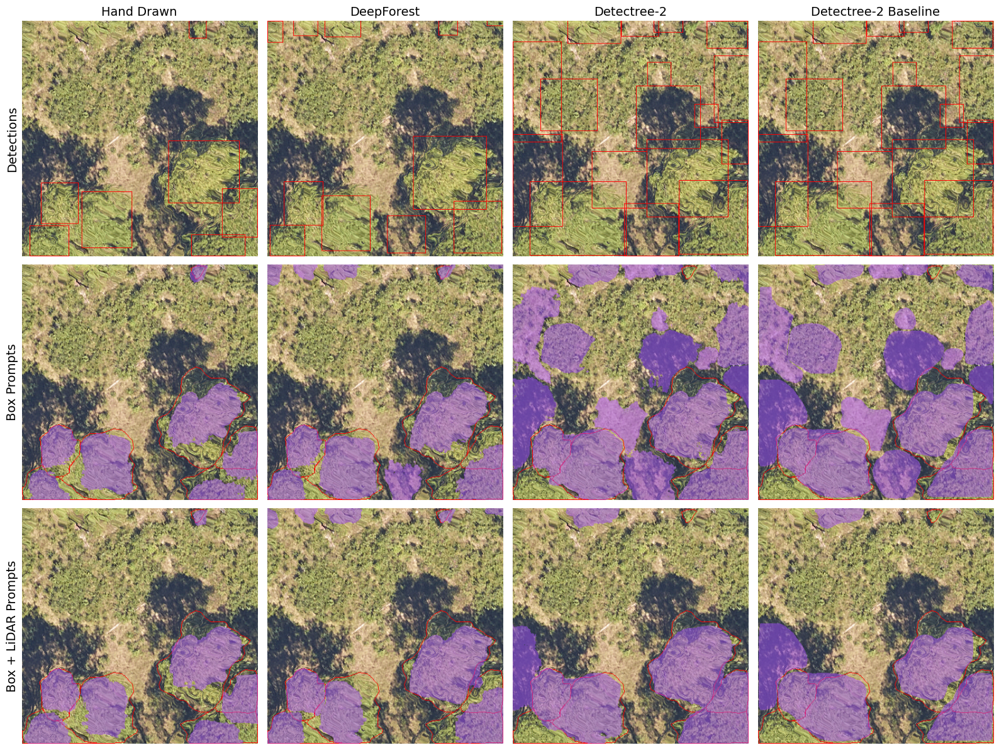

...

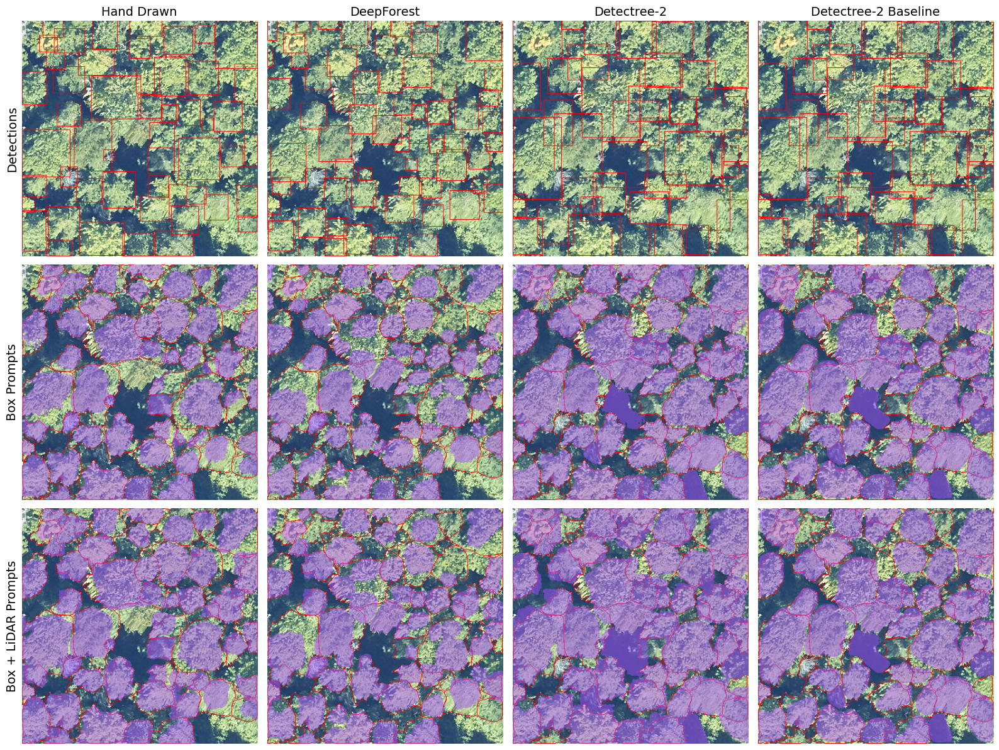

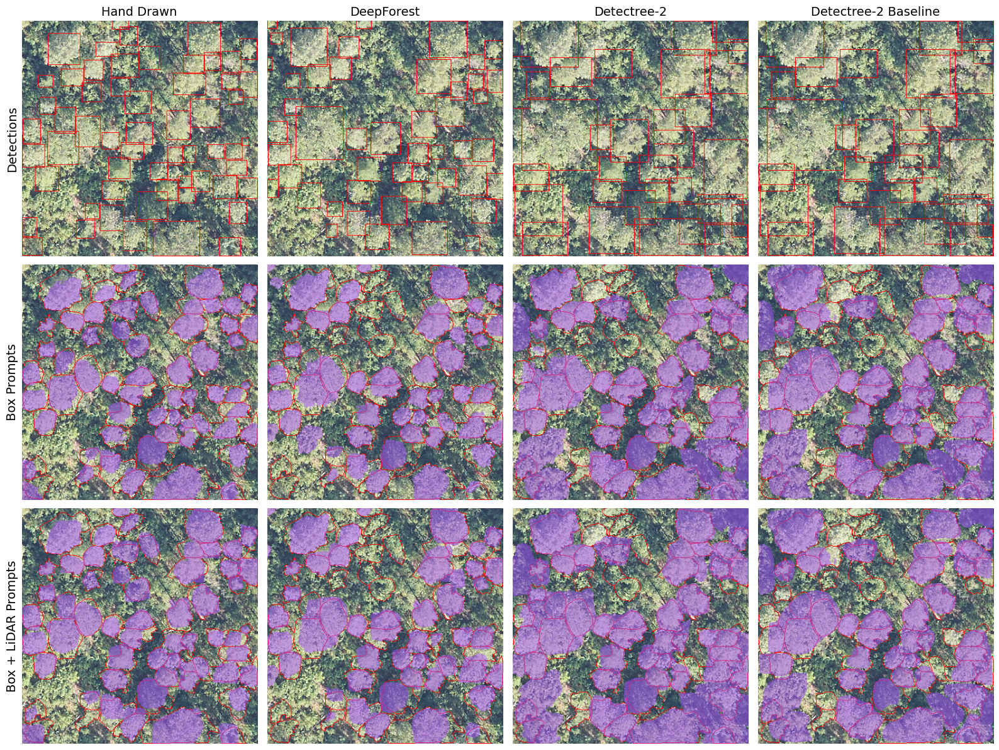

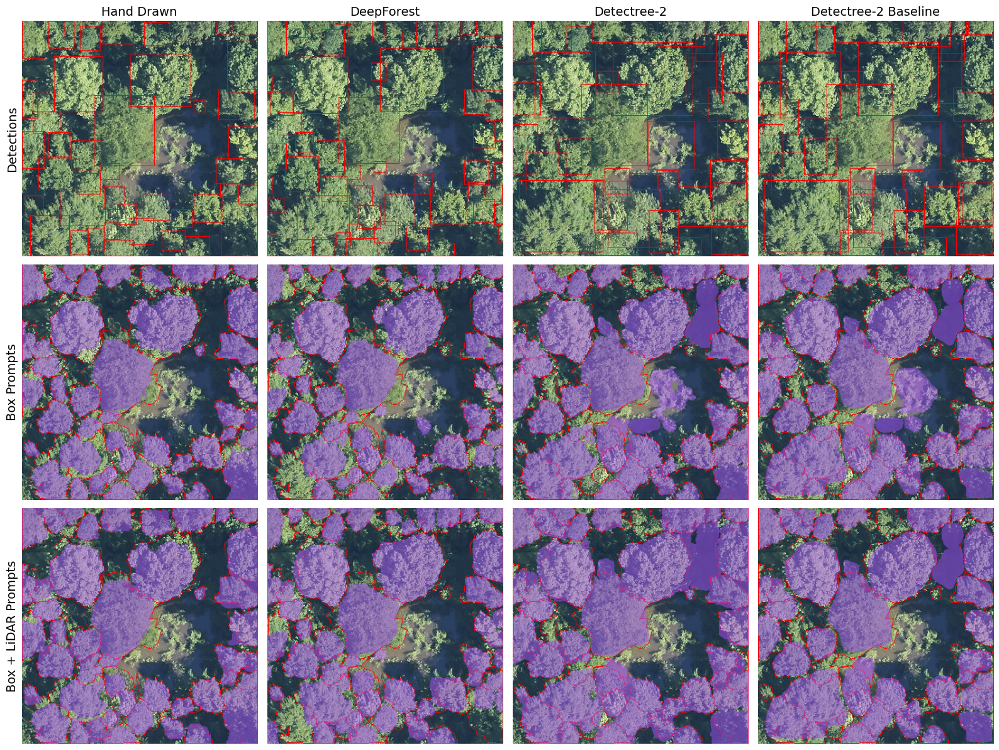

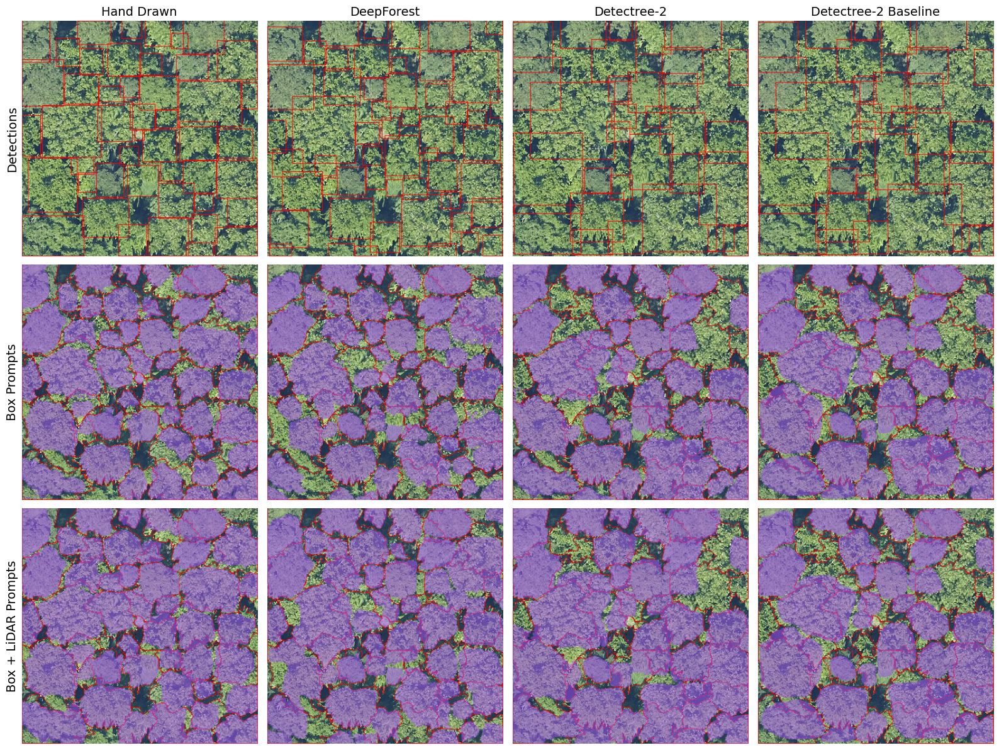

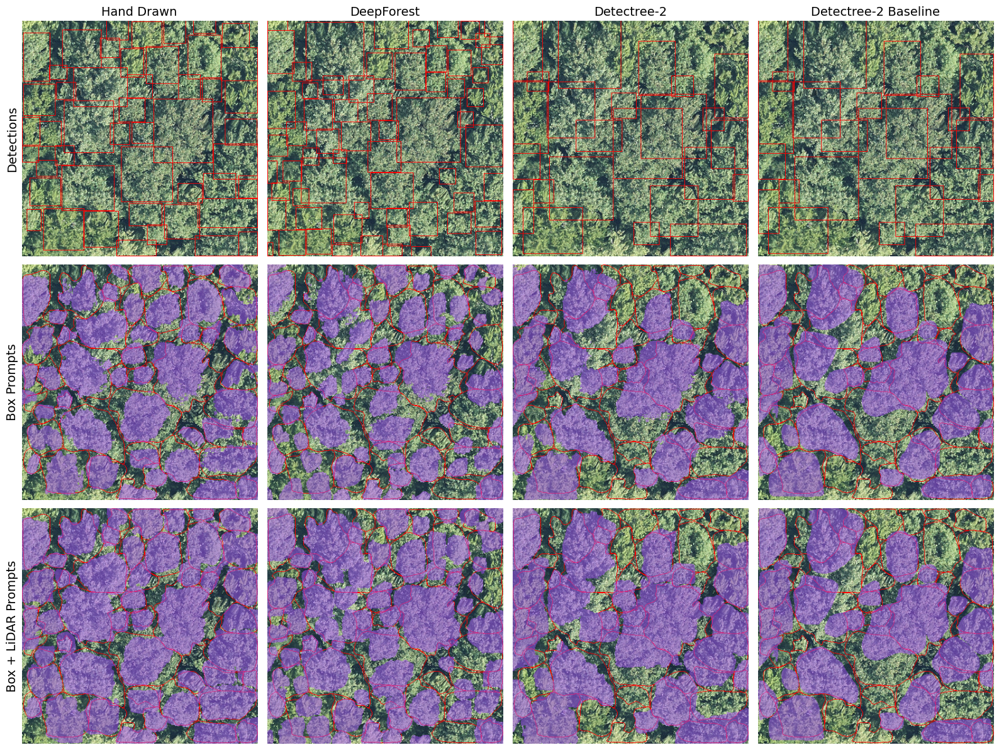

In [ ]:
for filename, difficulty in test_imgs:
  # Get image
  img = ds.get_image(filename)
  rgb_img = img['rgb']
  bgr_img = rgb_img[:,:,::-1].copy()
  sam_predictor.set_image(rgb_img)

  # Collect true bounding boxes and masks
  true_boxes = img['annotation']
  true_masks = get_masks(filename, rgb_folder, os.path.join(shape_folder, f'{difficulty}_annotate'))

  # Align true bounding boxes and masks
  box_idx, mask_idx = hungarian_matching(true_boxes, true_masks)
  true_boxes = true_boxes[box_idx]
  true_masks = true_masks[mask_idx]

  # Collect hand-drawn bounding boxes
  hand_boxes = img['annotation']

  # Generate automatic bounding boxes using DeepForest
  df_boxes = df_model.predict_image(image=rgb_img.astype('float32'), return_plot=False)
  # Filter with confidence threshold of 0.2
  df_boxes = df_boxes[df_boxes['score'] >= 0.2]
  df_scores = df_boxes['score'].to_numpy()
  df_boxes = df_boxes[['xmin','ymin','xmax','ymax']].to_numpy()
  # Apply custom non-max suppression
  df_detections = sv.Detections(xyxy=df_boxes, confidence=df_scores, class_id=np.zeros(len(df_scores),dtype='int'))
  df_idx = custom_nms(df_detections, threshold=0.5)
  df_boxes = df_boxes[df_idx]
  df_scores = df_scores[df_idx]

  # Generate automatic bounding boxes using Detectree2
  dt_outputs = dt_model(bgr_img)
  dt_boxes = dt_outputs['instances'].pred_boxes.tensor.cpu().numpy()
  dt_scores = dt_outputs['instances'].scores.cpu().numpy()
  dt_classes = dt_outputs['instances'].pred_classes.cpu().numpy()
  dt_cnn_masks = dt_outputs['instances'].pred_masks.cpu().numpy()
  # Filter with confidence threshold of 0.2
  dt_idx = np.nonzero(dt_scores >= 0.2)
  dt_boxes = dt_boxes[dt_idx]
  dt_scores = dt_scores[dt_idx]
  dt_classes = dt_classes[dt_idx]
  dt_cnn_masks = dt_cnn_masks[dt_idx]
  # Apply custom non-max suppression
  dt_detections = sv.Detections(xyxy=dt_boxes, confidence=dt_scores, class_id=dt_classes)
  dt_idx = custom_nms(dt_detections, threshold=0.5)
  dt_boxes = dt_boxes[dt_idx]
  dt_scores = dt_scores[dt_idx]
  dt_classes = dt_classes[dt_idx]
  dt_cnn_masks_1 = dt_cnn_masks[dt_idx]
  dt_cnn_boxes_1 = dt_boxes.copy()

  # Segment using SAM-2
  hand_masks = segment_boxes(sam_predictor, hand_boxes, threshold=0.2)
  df_masks = segment_boxes(sam_predictor, df_boxes, threshold=0.2)
  dt_masks = segment_boxes(sam_predictor, dt_boxes, threshold=0.2)

  # Match predicted masks to boxes
  box_idx, mask_idx = hungarian_matching(hand_boxes, hand_masks)
  hand_boxes_1, hand_masks_1 = hand_boxes[box_idx], hand_masks[mask_idx]
  box_idx, mask_idx = hungarian_matching(df_boxes, df_masks)
  df_boxes_1, df_masks_1 = df_boxes[box_idx], df_masks[mask_idx]
  box_idx, mask_idx = hungarian_matching(dt_boxes, dt_masks)
  dt_boxes_1, dt_masks_1 = dt_boxes[box_idx], dt_masks[mask_idx]

  # Use boxes to label LiDAR points
  hand_coords, hand_labels = rasterize_lidar(lidar_folder, rgb_folder, filename, boxes=hand_boxes)
  df_coords, df_labels = rasterize_lidar(lidar_folder, rgb_folder, filename, boxes=df_boxes)
  dt_coords, dt_labels = rasterize_lidar(lidar_folder, rgb_folder, filename, boxes=dt_boxes)

  # Use labeled LiDAR points to filter boxes
  idx = lidar_filter(hand_boxes, hand_coords, hand_labels, threshold=0.2)
  hand_boxes, hand_labels = hand_boxes[idx], hand_labels[idx]
  idx = lidar_filter(df_boxes, df_coords, df_labels, threshold=0.2)
  df_boxes, df_labels = df_boxes[idx], df_labels[idx]
  idx = lidar_filter(dt_boxes, dt_coords, dt_labels, threshold=0.2)
  dt_boxes, dt_labels = dt_boxes[idx], dt_labels[idx]
  dt_cnn_boxes_2, dt_cnn_masks_2 = dt_cnn_boxes_1[idx], dt_cnn_masks_1[idx]

  # Sample LiDAR points for SAM-2
  pos = 10
  neg = 10
  if len(hand_boxes) > 0:
    hand_coords, hand_labels = sample_points(hand_coords, hand_labels, pos_samples=pos, neg_samples=neg, distance_weight=True, neg_sample_spread=1, seed=seed)
  if len(df_boxes) > 0:
    df_coords, df_labels = sample_points(df_coords, df_labels, pos_samples=pos, neg_samples=neg, distance_weight=True, neg_sample_spread=1, seed=seed)
  if len(dt_boxes) > 0:
    dt_coords, dt_labels = sample_points(dt_coords, dt_labels, pos_samples=pos, neg_samples=neg, distance_weight=True, neg_sample_spread=1, seed=seed)

  # Segment using SAM-2
  if len(hand_boxes) > 0:
    hand_masks = segment_box_points(sam_predictor, hand_boxes, hand_coords, hand_labels, threshold=0.2, iterative=True)
  else:
    hand_masks = np.empty((0,400,400))
  if len(df_boxes) > 0:
    df_masks = segment_box_points(sam_predictor, df_boxes, df_coords, df_labels, threshold=0.2, iterative=True)
  else:
    df_masks = np.empty((0,400,400))
  if len(dt_boxes) > 0:
    dt_masks = segment_box_points(sam_predictor, dt_boxes, dt_coords, dt_labels, threshold=0.2, iterative=True)
  else:
    dt_masks = np.empty((0,400,400))

  # Match predicted masks to boxes
  box_idx, mask_idx = hungarian_matching(hand_boxes, hand_masks)
  hand_boxes_2, hand_masks_2 = hand_boxes[box_idx], hand_masks[mask_idx]
  box_idx, mask_idx = hungarian_matching(df_boxes, df_masks)
  df_boxes_2, df_masks_2 = df_boxes[box_idx], df_masks[mask_idx]
  box_idx, mask_idx = hungarian_matching(dt_boxes, dt_masks)
  dt_boxes_2, dt_masks_2 = dt_boxes[box_idx], dt_masks[mask_idx]

  true_detections = sv.Detections(xyxy=true_boxes,
                                  mask=true_masks,
                                  class_id=np.zeros(len(true_boxes), dtype='int'))

  hand_detections_1 = sv.Detections(xyxy=hand_boxes_1,
                                    mask=hand_masks_1,
                                    class_id=np.zeros(len(hand_boxes_1), dtype='int'))

  hand_detections_2 = sv.Detections(xyxy=hand_boxes_2,
                                    mask=hand_masks_2,
                                    class_id=np.zeros(len(hand_boxes_2), dtype='int'))

  df_detections_1 = sv.Detections(xyxy=df_boxes_1,
                                  mask=df_masks_1,
                                  class_id=np.zeros(len(df_boxes_1), dtype='int'))

  df_detections_2 = sv.Detections(xyxy=df_boxes_2,
                                  mask=df_masks_2,
                                  class_id=np.zeros(len(df_boxes_2), dtype='int'))

  dt_detections_1 = sv.Detections(xyxy=dt_boxes_1,
                                  mask=dt_masks_1,
                                  class_id=np.zeros(len(dt_boxes_1), dtype='int'))

  dt_detections_2 = sv.Detections(xyxy=dt_boxes_2,
                                  mask=dt_masks_2,
                                  class_id=np.zeros(len(dt_boxes_2), dtype='int'))

  dt_cnn_detections_1 = sv.Detections(xyxy=dt_cnn_boxes_1,
                                      mask=dt_cnn_masks_1,
                                      class_id=np.zeros(len(dt_cnn_boxes_1), dtype='int'))

  dt_cnn_detections_2 = sv.Detections(xyxy=dt_cnn_boxes_2,
                                      mask=dt_cnn_masks_2,
                                      class_id=np.zeros(len(dt_cnn_boxes_2), dtype='int'))

  box_annotator = sv.BoxAnnotator(thickness=1, color=sv.Color.RED)
  poly_annotator = sv.PolygonAnnotator(thickness=1, color=sv.Color.RED)
  mask_annotator = sv.MaskAnnotator()
  true_img = poly_annotator.annotate(bgr_img.copy(), detections=true_detections)

  fig, axs = plt.subplots(nrows=3, ncols=4, figsize=(16, 12))
  hand_img_0 = box_annotator.annotate(bgr_img.copy(), detections=hand_detections_1)[:,:,::-1]
  df_img_0 = box_annotator.annotate(bgr_img.copy(), detections=df_detections_1)[:,:,::-1]
  dt_img_0 = box_annotator.annotate(bgr_img.copy(), detections=dt_detections_1)[:,:,::-1]
  dt_cnn_img_0 = box_annotator.annotate(bgr_img.copy(), detections=dt_cnn_detections_1)[:,:,::-1]

  hand_img_1 = mask_annotator.annotate(true_img.copy(), detections=hand_detections_1)[:,:,::-1]
  df_img_1 = mask_annotator.annotate(true_img.copy(), detections=df_detections_1)[:,:,::-1]
  dt_img_1 = mask_annotator.annotate(true_img.copy(), detections=dt_detections_1)[:,:,::-1]
  dt_cnn_img_1 = mask_annotator.annotate(true_img.copy(), detections=dt_cnn_detections_1)[:,:,::-1]

  hand_img_2 = mask_annotator.annotate(true_img.copy(), detections=hand_detections_2)[:,:,::-1]
  df_img_2 = mask_annotator.annotate(true_img.copy(), detections=df_detections_2)[:,:,::-1]
  dt_img_2 = mask_annotator.annotate(true_img.copy(), detections=dt_detections_2)[:,:,::-1]
  dt_cnn_img_2 = mask_annotator.annotate(true_img.copy(), detections=dt_cnn_detections_2)[:,:,::-1]

  axs[0,0].imshow(hand_img_0)
  axs[0,1].imshow(df_img_0)
  axs[0,2].imshow(dt_img_0)
  axs[0,3].imshow(dt_cnn_img_0)

  axs[1,0].imshow(hand_img_1)
  axs[1,1].imshow(df_img_1)
  axs[1,2].imshow(dt_img_1)
  axs[1,3].imshow(dt_cnn_img_1)

  axs[2,0].imshow(hand_img_2)
  axs[2,1].imshow(df_img_2)
  axs[2,2].imshow(dt_img_2)
  axs[2,3].imshow(dt_cnn_img_2)

  axs[0,0].set_title('Hand Drawn', fontsize=14)
  axs[0,1].set_title('DeepForest', fontsize=14)
  axs[0,2].set_title('Detectree-2', fontsize=14)
  axs[0,3].set_title('Detectree-2 Baseline', fontsize=14)
  axs[0,0].set_ylabel('Detections', fontsize=14)
  axs[1,0].set_ylabel('Box Prompts', fontsize=14)
  axs[2,0].set_ylabel('Box + LiDAR Prompts', fontsize=14)
  for i in range(3):
    for j in range(4):
      axs[i,j].set_frame_on(False)
      axs[i,j].get_xaxis().set_ticks([])
      axs[i,j].get_yaxis().set_ticks([])
  plt.tight_layout()
  plt.savefig(f'{filename} segmentation.jpg')
  plt.show()

**Selected Images**

**Easy:** 2018_TEAK_3_318000_4107000_image_718

**LiDAR labels:**

Manual: 0

DeepForest: 0

Detectree2: 5?

**Medium:** DSNY_025_2018 or WREF_072_2019

**LiDAR labels:**

Manual: 35 or 5

DeepForest: 43 or 14

Detectree2: 4 or 5

**Hard:** DELA_047_2019

**LiDAR labels:**

Manual: 37

DeepForest: 11

Detectree2: 1